### A project by Villads Zimakoff

# Kuramoto-Sivashinsky in 1D
The kuramoto-Sivashinsky equation is a fourth order nonlinear PDE. It is used to model phenomena such as thermal instabilities in flame fronts and fluid dynamics. Mosty importantly for this project, the Kuramoto-Sivashinsky equation is known to exhibit chaotic properties highly sensitive to intial condtions within certain parameter domains. The focus of this project will be on deriving a numerical solution to the problem in 1D and 2D, aswell as investigate the behavior for given varrying domain sizes and intial conditions.  

Troughout this project i will use the notation:  
$\partial_{x  n} \rightarrow$ implies n times implicit differentiation of the given function with respect to x.  
$\ast \rightarrow$ will symbolize the convolution operator.  


 For the one dimensional function $u(x)$, the standard form for the Kuramoto-Sivashinsky equation is  
 
$$\begin{align*}
  \frac{du}{dt}   &= - \frac{1}{2} uu_{x} - u_{xx} - u_{xxxx}.  \\
\end{align*}$$

We then apply a quasi implicit discretization, relaxing the nonlinear term $uu_{x}$  

$$\begin{equation*}
  u_{t+\Delta t} = u_{t} - \Delta t(\frac{1}{2}u_{t} \partial_{x} u_{t} +\partial_{xx} u_{t+\Delta t} + \partial_{xxxx} u_{t+\Delta t}). \\ 
 \end{equation*}$$
 
Next we transform our equation from the spatial domain $u(x)$ into the frequency domain $\hat u(k)$ via the Fourier transformation. Note that any multiplicative term here transforms to become a convolution. 
  
  $$\begin{equation*}
\hat u_{t+\Delta t} = \hat u_{t} - \Delta t(\frac{1}{2} ( \hat u_{t} \ast ik_{x}\hat u_{t}) -k_{x}^2 \hat u_{t+\Delta t} + k_{x}^4\hat u_{t+\Delta t}). 
 \end{equation*}$$  
 
We then factor the implicit terms and isolate for the solution 

  $$\begin{equation*}
(1+\Delta t(k_{x}^4 - k_{x}^2 ))\hat u_{t+\Delta t} = \hat u_{t} - \Delta t\frac{1}{2}  (\hat u_{t} \ast ik_{x}\hat u_{t}) \\
\hat u_{t+\Delta t} = \frac{\hat u_{t} - \Delta t\frac{1}{2}  (\hat u_{t} \ast ik_{x}\hat u_{t})}{1+\Delta t(k_{x}^4 - k_{x}^2 )}. 
 \end{equation*}$$
 
But as the convolution operation is rather computationally expensive, we instead exploit the Fourier transform once again:

$$\begin{equation*}
\hat u_{t} \ast ik_{x}\hat u_{t} =  \mathcal{F} \{u_{t} \cdot \mathcal{F}^{-1} \{ ik_{x} \hat u_{t}\} \}.
\end{equation*}$$

To get the solution in the spatial domain we simple apply an inverse transformation. We now move to the implementation. Here we use a couple of "tricks" to further increase both speed and memory usage. Firstly the above term in the denominator is constant and can therefore be precomputed $\textit{once}$ and resued every loop. Secondly i use the pyfftw.interface to speed up numpy's Fourier transformations. 

In [26]:
pyfftw.interfaces.cache.enable()

def update(u, k_x, denominator, dt):
    u_trans = pyfftw.interfaces.numpy_fft.fft(u)
    
    u_x = np.real(pyfftw.interfaces.numpy_fft.ifft(1j * k_x * u_trans))
        
    nonlinear_term = dt * pyfftw.interfaces.numpy_fft.fft(u * u_x) / 2
    
    u_trans_next = ( u_trans - nonlinear_term  ) / denominator 
    
    u_new = np.real(pyfftw.interfaces.numpy_fft.ifft(u_trans_next))
    
    return u_new

def sim(N, L, u_i, t_max, dt):
    k_x = 2 * np.pi * fft.fftfreq(N, L / N)
    denominator = 1 + dt*(k_x**4 - k_x**2)
    
    u = u_i
    t, n = 0, 0
    u_sol, t_list = [], []
    while t < t_max:
        u = update(u, k_x, denominator, dt)
        if n % int(1/(10*dt)) == 0:
            u_sol.append(u)
            t_list.append(t)
        t += dt
        n += 1
        
    return np.array(u_sol), np.array(t_list)

We now wish to observe how changing the spatial granularity $d_{x} = \frac{L}{N}$ changes the dynamics of the systems.

For a low value $L_{x} = 1\pi$, the system instantly smoothens out, comepletly negating the intial condition.

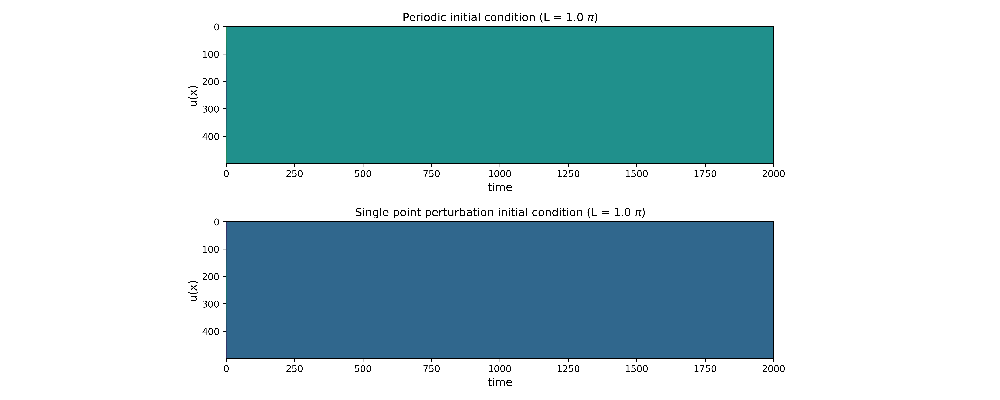

In [25]:
display(Image('images/L = 1.0pi.png'))

Doubling the value of $dx$, we get a stable system that remains constant through time.

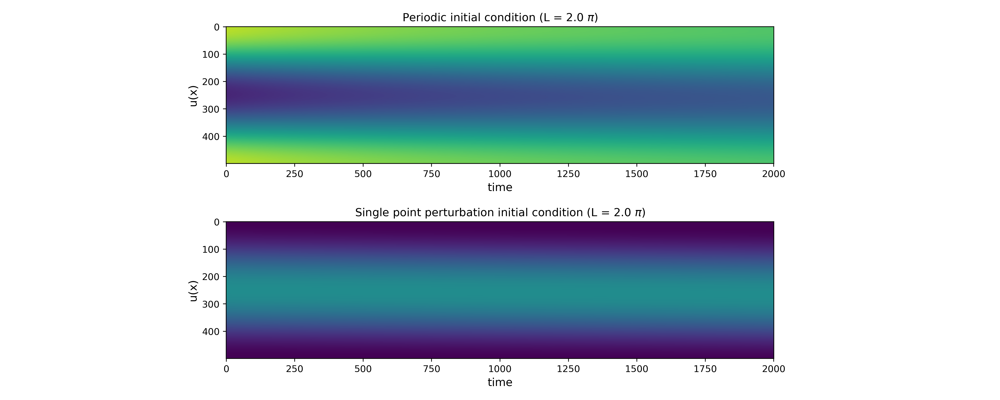

In [27]:
display(Image('images/L = 2.0pi.png'))

At $L = 8\pi$ we start to see more dynamical behavior. Notice however that the single point pertubation still stablizes halfway through.

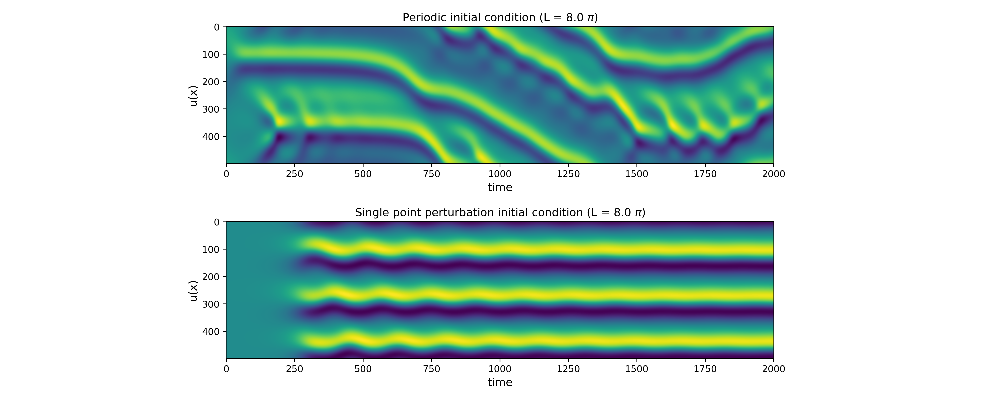

In [28]:
display(Image('images/L = 8.0pi.png'))

Increasing the granularity another four fold, we get the desired outcome! True chaotic dynamics.

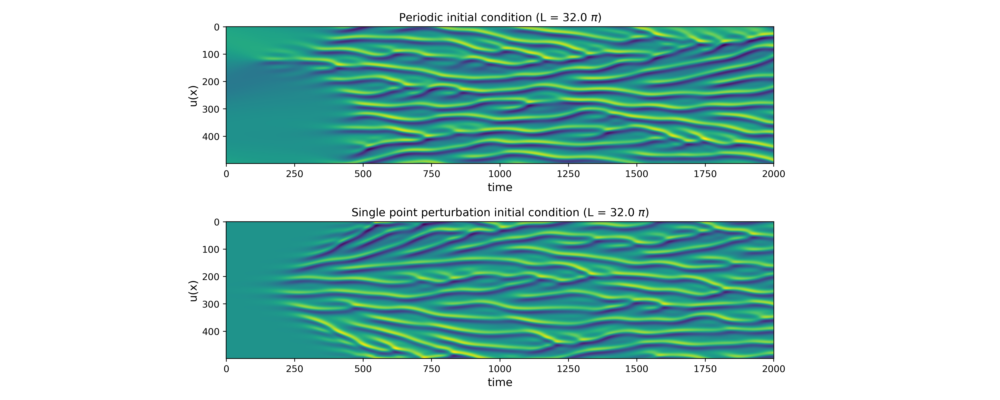

In [23]:
display(Image('images/L = 32.0pi.png'))

# Kuramoto-Sivashinsky in 2D

 For the two dimensional function $u(x,y)$, the standard form for the Kuramoto-Sivashinsky equation is:  
 
$$\begin{align*}
  \frac{du}{dt}   &= - \frac{1}{2} |\nabla u|^{2} -\nabla^{2}u - \nabla^{4}u. \\
\end{align*}$$
To which we apply the quasi implicit discretization
$$\begin{equation*}
  u_{t+\Delta t} = u_{t} - \Delta t(\frac{1}{2} |\nabla u_{t}|^{2} +\nabla^{2}u_{t+\Delta t} + \nabla^{4}u_{t+\Delta t}) \\ 
  u_{t+\Delta t} = u_{t} - \Delta t(\frac{1}{2} ((\partial_{x} u_{t})^{2} + (\partial_{y} u_{t})^{2}) +(\partial_{xx} + \partial_{yy} )u_{t+\Delta t} + (\partial_{xxxx}  + \partial_{yyyy} + 2\partial_{xxyy})u_{t+\Delta t}). \\ 
 \end{equation*}$$
Note that since u is a scalar field, the absolute value of its gradient squared is
$|\nabla u_{t}|^{2} = (\sqrt{(\partial_{x} u_{t})^{2} + (\partial_{y} u_{t})^{2}})^{2} = (\partial_{x} u_{t})^{2} + (\partial_{y} u_{t})^{2}.$  

If we now fourier-transform
  
  $$\begin{equation*}
\hat u_{t+\Delta t} = \hat u_{t} - \Delta t(\frac{1}{2} ( (ik_{x} \hat u_{t} \ast ik_{x}\hat u_{t}) + (ik_{y} \hat u_{t} \ast ik_{y}\hat u_{t})) -(k_{x}^2 + k_{y}^2)\hat u_{t+\Delta t} + (k_{x}^4 + k_{y}^4 + 2k_{x}^{2}k_{y}^2)\hat u_{t+\Delta t}) \\
(1+\Delta t(k_{x}^4 + k_{y}^4 + 2k_{x}^{2}k_{y}^2 - k_{x}^2 - k_{y}^2))\hat u_{t+\Delta t} = \hat u_{t} - \Delta t\frac{1}{2}  ((ik_{x} \hat u_{t} \ast ik_{x}\hat u_{t}) + (ik_{y} \hat u_{t} \ast ik_{y}\hat u_{t})) \\
\hat u_{t+\Delta t} = \frac{\hat u_{t} - \Delta t\frac{1}{2}  ((ik_{x} \hat u_{t} \ast ik_{x}\hat u_{t}) + (ik_{y} \hat u_{t} \ast ik_{y}\hat u_{t}))}{1+\Delta t(k_{x}^4 + k_{y}^4 + 2k_{x}^{2}k_{y}^2 - k_{x}^2 - k_{y}^2)}. 
 \end{equation*}$$
 
Again we use the multiplicative property of the convolution in the spatial domain:

$$\begin{equation*}
ik_{x} \hat u_{t} \ast ik_{x}\hat u_{t} = \mathcal{F}\{ \mathcal{F}^{-1} \{ ik_{x} \hat u_{t}\} \cdot \mathcal{F}^{-1} \{ ik_{x} \hat u_{t}\} \}.
\end{equation*}$$


Taking the inverse Fourier transform we then obtain a solution and implementation analogue to before, but in two dimensions. It is however important, that since we are taking a two dimensional Fourier transformation, we handle our wave numbers and transformations carefully. This step crucial, as it is possible for energy to "leak" into the complex plane.  Further the domain size is asumed to be square so that $L_{x} = L_{y} = L$.  
  
Below is the implmentation.

In [313]:
pyfftw.interfaces.cache.enable()

def update(u, k_x, k_y, denominator, dt):
    u_trans = pyfftw.interfaces.numpy_fft.rfft2(u)
    
    u_x = pyfftw.interfaces.numpy_fft.irfft2(1j * k_x * u_trans)
    u_y = pyfftw.interfaces.numpy_fft.irfft2(1j * k_y * u_trans)
        
    nonlinear_term = dt * pyfftw.interfaces.numpy_fft.rfft2(u_x * u_x + u_y * u_y) / 2
    
    u_trans_next = ( u_trans - nonlinear_term  ) / denominator 
    
    u_new = pyfftw.interfaces.numpy_fft.irfft2(u_trans_next)
    
    return u_new

def sim(N, L, u_i, t_max, dt):
    k_x, k_y = np.meshgrid(2 * np.pi * fft.rfftfreq(N, L/N), 2 * np.pi * fft.fftfreq(N, L/N))
    denominator = 1 + dt*(k_x**4 + k_y**4 + 2 * k_x**2 * k_y**2 - k_x**2 - k_y**2)
    
    u = u_i
    t, n = 0, 0
    u_sol = []
    while t < t_max:
        u = update(u, k_x, k_y, denominator, dt)
        if n % int(1/(5*dt)) == 0:
            u_sol.append(u)
        t += dt
        n += 1
        
    return u_sol

Now for high values of L, we would expect to see the same chaotic propperties we observed in 1D. There is a just one problem with our approach in 2D. Although our PDE is the true generaliation from 1D $\rightarrow$ 2D, it does not inherrent all the same properties. As the technical details are a bit beyond this project (and my comprehension) i will refer to chapters 8 and 9 in the PHD thesis "Nonlinear dynamics of surfactant–laden multilayer shear flows and related systems" by Anna Kalogirou. The crux of the problem is that in one dimension the kuramoto Sivashinsky equation is what is called a mean field equation. This ensure that while the system evovles, it's mean value will stay zero, and thus conserve energy. This is however $\textit{not}$ the case for the 2D equivalent. This results in a net negative energy time evolution of the system that alters it's dynamics. Below is the time evolution (left to right) of the same initial conditions used before. One with a symmetric initial condition and one with a periodic field. 
  
We simulate using: $dt = 0.01$, $N = 200$ and $L = 32\pi$

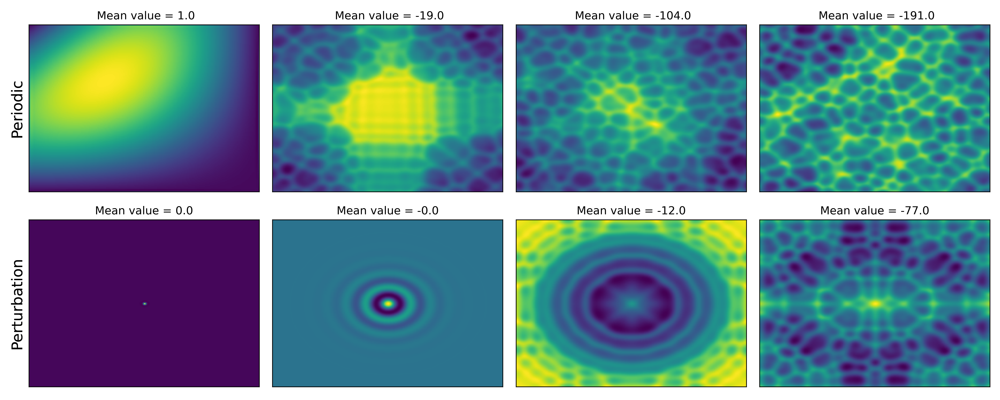

In [18]:
display(Image('images/2.png'))

This "exploding" average not only breaks the physical interpertation of the system, but also makes animating it extremely tedious.  
To fix this we simply consider the 2D mean field equation
$$\begin{equation*}
  w_{t}   = u_{t} - \overline{u_{t}} .
\end{equation*}$$  
  
We simulate using: $dt = 0.01$, $N = 400$ and $L = 64\pi$

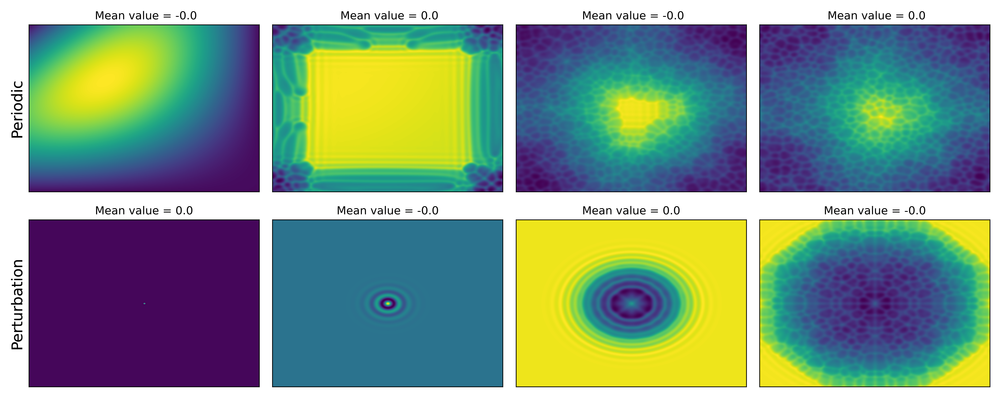

In [31]:
display(Image('images/5.png'))

Flipping the sign on the nonlinear term $\frac{1}{2} |\nabla u|^{2}$ corresponds to flipping the XY-plane, producing the counterpart to the above

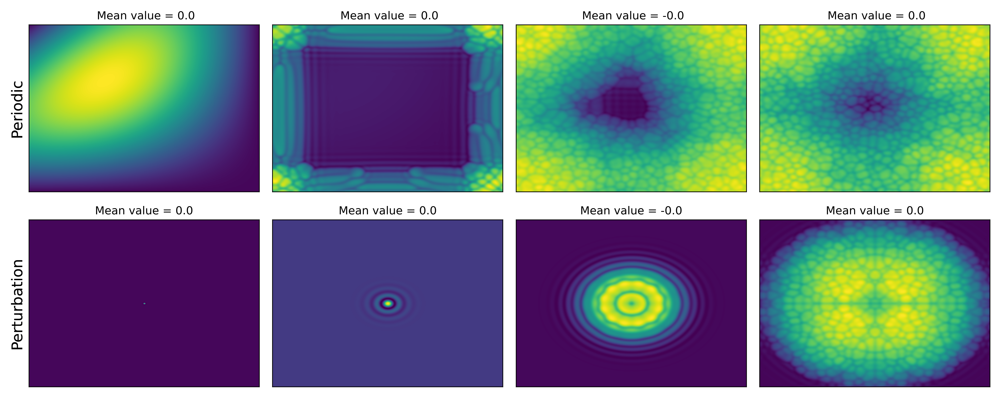

In [33]:
display(Image('images/3.png'))

If we let the perturbed system run long enough the symmetry will eventually break, producing the following chaotic field.

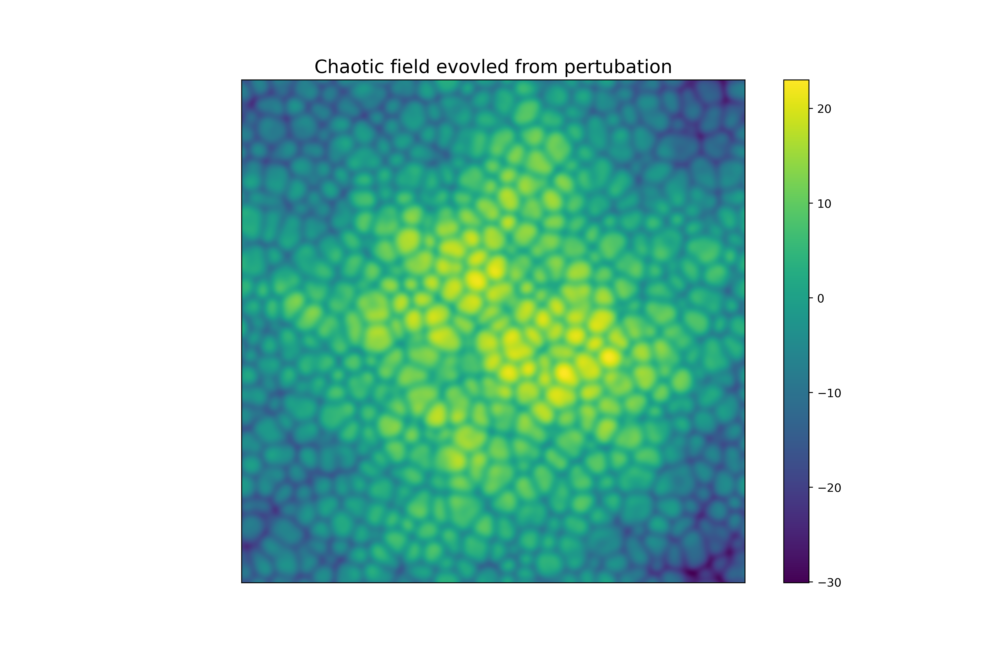

In [30]:
display(Image('images/4.png'))

This could possibly be a result of compounding computational errors. Most importantly though, the stability of the system, as discussed in the 1D section, is detirmend by the granularity. Repeating the symmertric pertubation for a smaller system with lower granularity over the same time span, we observe more consistent symmetric pattern formation.

$dt = 0.01$, $N = 200$ and $L = 24\pi$

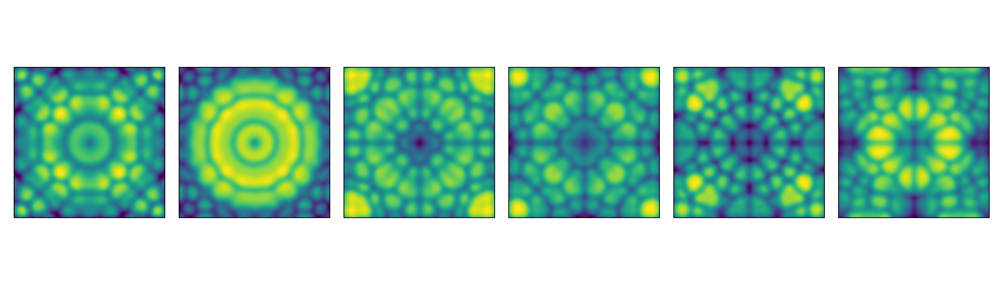

In [3]:
display(Image('images/6.png'))

I will further attach some cool animation :D